In [1]:
@show VERSION
@time using DifferentialEquations
@time using Plots
@time using ProgressMeter
@time using Fmt # pkg> add https://github.com/bicycle1885/Fmt.jl

VERSION = v"1.7.0"
 11.215253 seconds (29.92 M allocations: 2.031 GiB, 5.79% gc time, 24.52% compilation time)
  5.525246 seconds (12.38 M allocations: 837.098 MiB, 4.37% gc time, 15.31% compilation time)
  0.006006 seconds (10.54 k allocations: 565.438 KiB)
  0.003685 seconds (4.93 k allocations: 405.172 KiB)


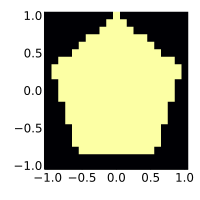

In [2]:
x ⪅ y = x < y || x ≈ y

function isin_ngon(n, R, x, y)
    x, y = y, x
    α = 2π/n
    θ = mod(angle(x + im*y), α)
    r = √(x^2 + y^2) / R
    X, Y = r*cos(θ), r*sin(θ)
    (1 - cos(α))*Y ⪅ sin(α)*(1 - X)
end

isin_unit_pentagon(x, y) = isin_ngon(5, 1, x, y)

x = -1:0.1:1
y = -1:0.1:1
D = isin_unit_pentagon.(x, y')
heatmap(x, y, D'; colorbar=false, size=(200, 200))

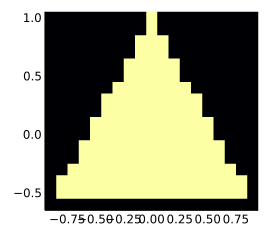

In [3]:
isin_equilateral_triangle(x, y) = isin_ngon(3, 1, x, y)
x = -0.9:0.1:0.9
y = -0.6:0.1:1
D = isin_equilateral_triangle.(x, y')
heatmap(x, y, D'; colorbar=false, size=(270, 240))

In [4]:
module My

struct Param{TX, TY, TH, TV, TE, TB, TV_dic}
    x::TX
    y::TY
    h⁻¹::TH
    h⁻²::TH
    V::TV
    E::TE
    B::TB
    V_dic::TV_dic
end

Base.length(p::Param) = length(p.V)
Base.size(p::Param) = (length(p.x), length(p.y))

mystep(x::AbstractVector) = x[2] - x[1]
mystep(x::StepRangeLen) = step(x)

function Param(isin_func, x::AbstractVector, y::AbstractVector)
    @assert mystep(x) == mystep(y)
    h⁻¹ = 1/mystep(x)
    h⁻² = 1/mystep(x)^2
    I, J = eachindex(x), eachindex(y)
    D = isin_func.(x, y')
    V = Tuple{Int64, Int64}[]
    E_mat = [Tuple{Int64, Int64}[] for i in I, j in J]
    B_mat = [Tuple{Int64, Int64}[] for i in I, j in J]
    for j in J, i in I
        if D[i, j]
            push!(V, (i, j))
            for (p, q) in ((-1, 0), (1, 0), (0, -1), (0, 1))
                if i+p in I && j+q in J && D[i+p, j+q]
                    push!(E_mat[i, j], (i+p, j+q))
                else
                    D[i-p, j-q] && push!(B_mat[i, j], (i-p, j-q))
                end
            end
        end
    end
    V_dic = Dict(V[k] => k for k in eachindex(V))
    E = [getindex.(Ref(V_dic), E_mat[V[k]...]) for k in eachindex(V)]
    B = [getindex.(Ref(V_dic), B_mat[V[k]...]) for k in eachindex(V)]
    Param(x, y, h⁻¹, h⁻², V, E, B, V_dic)
end

function vec2mat!(p::Param, u, U)
    (; V) = p
    for k in eachindex(V)
        U[V[k]...] = u[k]
    end
    U
end
    
function vec2mat(p::Param, u; default_value=NaN)
    U = fill(eltype(u)(default_value), size(p))
    vec2mat!(p, u, U)
end

function mat2vec!(p::Param, U, u)
    (; V_dic) = p
    for t in keys(V_dic)
        u[V_dic[t]] = U[t...]
    end
    u
end

function mat2vec(p::Param, U)
    u = similar(eltype(U)[], length(p))
    mat2vec!(p, U, u)
end

end

x = -1:0.1:1
y = -1:0.1:1
p = My.Param(isin_unit_pentagon, x, y)

(; h⁻², V, E, B) = p
@show h⁻²

for k in (18, 19, 32, 131)
    @show k
    @show V[k]
    @show E[k]
    @show B[k]
    @show V[E[k]]
    @show V[B[k]]
    println("-"^80)
end

u0 = collect(1.0:length(V))
U0 = Int.(My.vec2mat(p, u0; default_value=0))
@show My.mat2vec(p, U0) == u0
U0'

h⁻² = 99.99999999999999
k = 18
V[k] = (11, 4)
E[k] = [17, 19, 6, 31]
B[k] = Int64[]
V[E[k]] = [(10, 4), (12, 4), (11, 3), (11, 5)]
V[B[k]] = Tuple{Int64, Int64}[]
--------------------------------------------------------------------------------
k = 19
V[k] = (12, 4)
E[k] = [18, 20, 7, 32]
B[k] = Int64[]
V[E[k]] = [(11, 4), (13, 4), (12, 3), (12, 5)]
V[B[k]] = Tuple{Int64, Int64}[]
--------------------------------------------------------------------------------
k = 32
V[k] = (12, 5)
E[k] = [31, 33, 19, 45]
B[k] = Int64[]
V[E[k]] = [(11, 5), (13, 5), (12, 4), (12, 6)]
V[B[k]] = Tuple{Int64, Int64}[]
--------------------------------------------------------------------------------
k = 131
V[k] = (4, 12)
E[k] = [130, 132, 114, 149]
B[k] = Int64[]
V[E[k]] = [(3, 12), (5, 12), (4, 11), (4, 13)]
V[B[k]] = Tuple{Int64, Int64}[]
--------------------------------------------------------------------------------
My.mat2vec(p, U0) == u0 = true


21×21 adjoint(::Matrix{Int64}) with eltype Int64:
 0    0    0    0    0    0    0    0  …    0    0    0    0    0    0  0
 0    0    0    0    0    0    0    0       0    0    0    0    0    0  0
 0    0    0    0    0    1    2    3      10   11    0    0    0    0  0
 0    0    0    0   12   13   14   15      22   23   24    0    0    0  0
 0    0    0    0   25   26   27   28      35   36   37    0    0    0  0
 0    0    0    0   38   39   40   41  …   48   49   50    0    0    0  0
 0    0    0   51   52   53   54   55      62   63   64   65    0    0  0
 0    0    0   66   67   68   69   70      77   78   79   80    0    0  0
 0    0    0   81   82   83   84   85      92   93   94   95    0    0  0
 0    0   96   97   98   99  100  101     108  109  110  111  112    0  0
 0    0  113  114  115  116  117  118  …  125  126  127  128  129    0  0
 0    0  130  131  132  133  134  135     142  143  144  145  146    0  0
 0  147  148  149  150  151  152  153     160  161  162  163  

In [5]:
function anim_sol2D(sol; L=201, fps=20, fn="tmp.gif",
        clim=(-0.06, 0.06), color=:bwr, bg=:lightgray)
    (; prob, u) = sol
    (; tspan, p) = prob
    (; x, y) = p
    ts = range(tspan...; length=L) |> r -> [fill(r[1], 20); r; fill(r[end], 20)]
    prog = Progress(length(ts), 0)
    anim = @animate for t in ts
        U = My.vec2mat(p, sol(t).x[2])
        heatmap(x, y, U'; colorbar=false, clim, color, bg)
        title!(f"t = {$t:4.2f}"; titlefontsize=12)
        plot!(size=(420, 440), xlim=extrema(x), ylim=extrema(y), aspectratio=1)
        next!(prog)
    end
    gif(anim, fn; fps)
end

function plot_sol(sol, t; zlim=(-0.06, 0.06),
        color=:bwr, bg=:lightgray, camera=(30, 85), size=(640, 480), kwargs...)
    (; prob, u) = sol
    (; tspan, p) = prob
    (; x, y) = p
    U = My.vec2mat(p, sol(t).x[2])
    surface(x, y, U'; colorbar=false, zlim, color, bg, camera, size)
    title!(f"t = {$t:5.2f}"; titlefontsize=12)
    plot!(; kwargs...)
end

function anim_sol(sol; L=101, fps=10, fn="tmp.gif", zlim=(-0.06, 0.06),
        color=:bwr, bg=:lightgray, camera=(30, 85), size=(640, 480), kwargs...)
    (; prob, u) = sol
    (; tspan, p) = prob
    (; x, y) = p
    umin = minimum(minimum(u.x[2]) for u in u)
    umax = maximum(maximum(u.x[2]) for u in u)
    ts = range(tspan...; length=L) |> r -> [fill(r[1], 20); r; fill(r[end], 20)]
    prog = Progress(length(ts), 0)
    anim = @animate for t in ts
        plot_sol(sol, t; color, bg, camera, size, zlim, kwargs...)
        next!(prog)
    end
    gif(anim, fn; fps)
end

anim_sol (generic function with 1 method)

In [6]:
function g!(dv, v, u, p, t)
    (; h⁻², E) = p
    @inbounds for k in eachindex(dv)
        dv[k] = h⁻² * sum(u[l] - u[k] for l in E[k])
    end
end

function g_dirichlet!(dv, v, u, p, t)
    (; h⁻², E) = p
    @inbounds for k in eachindex(dv)
        dv[k] = h⁻² * (
            sum(u[l] - u[k] for l in E[k]; init=0.0) - (4 - length(E[k])) * u[k]
        )
    end
end

function g_neumann!(dv, v, u, p, t)
    (; h⁻², E, B) = p
    @inbounds for k in eachindex(dv)
        dv[k] = h⁻² * (
            sum(u[l] - u[k] for l in E[k]; init=0.0) + sum(u[l] - u[k] for l in B[k]; init=0.0)
        )
    end
end

function g_absorbing!(dv, v, u, p, t)
    (; h⁻¹, h⁻², E, B) = p
    @inbounds for k in eachindex(dv)
        dv[k] = h⁻² * (
            sum(u[l] - u[k] for l in E[k]; init=0.0) + sum(u[l] - u[k] for l in B[k]; init=0.0)
        ) - h⁻¹ * 2length(B[k]) * v[k]
    end
end

g_absorbing! (generic function with 1 method)

In [7]:
x = range(-0.9, 0.9; length=361)
y = range(-0.6, 1; length=321)
p = My.Param(isin_equilateral_triangle, x, y)
tspan = (0.0, 2.0)

F(a, b, c, x, y) = exp(-((x-a)^2+(y-b)^2)/(2c^2))
f(x, y) = F(0.0, 0.0, 0.01, x, y)
U0 = f.(x, y')
V0 = zero(U0)

u0 = My.mat2vec(p, U0)
v0 = My.mat2vec(p, V0);

In [8]:
tspan = (0.0, 2.0)
prob = SecondOrderODEProblem(g_dirichlet!, v0, u0, tspan, p)

sol = nothing; GC.gc()
@time sol = solve(prob; saveat=0.01)

(; u) = sol
umin = minimum(minimum(u.x[2]) for u in u)
umax = maximum(maximum(u.x[2]) for u in u)
@show umin, umax;

 11.893439 seconds (42.73 M allocations: 2.133 GiB, 4.55% gc time, 74.58% compilation time)
(umin, umax) = (-0.29967180989445613, 1.0)


Progress: 100%|█████████████████████████████████████████| Time: 0:00:20
┌ Info: Saved animation to 
│   fn = D:\OneDrive\public\0025\wave eq on triangle with dirichlet bc.gif
└ @ Plots D:\.julia\packages\Plots\FCM0H\src\animation.jl:114


Plots.AnimatedGif("D:\\OneDrive\\public\\0025\\wave eq on triangle with dirichlet bc.gif")
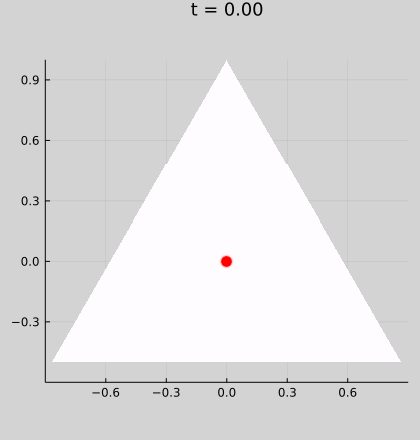

In [9]:
anim_sol2D(sol; fn="wave eq on triangle with dirichlet bc.gif", clim=(-0.05, 0.05))

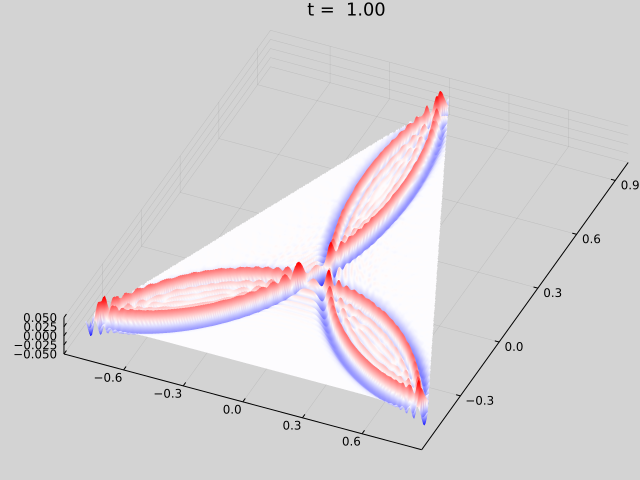

In [10]:
plot_sol(sol, 1.0; zlim=(-0.05, 0.05))

Progress: 100%|█████████████████████████████████████████| Time: 0:00:53
┌ Info: Saved animation to 
│   fn = D:\OneDrive\public\0025\wave eq on triangle with dirichlet bc 3d.gif
└ @ Plots D:\.julia\packages\Plots\FCM0H\src\animation.jl:114


Plots.AnimatedGif("D:\\OneDrive\\public\\0025\\wave eq on triangle with dirichlet bc 3d.gif")
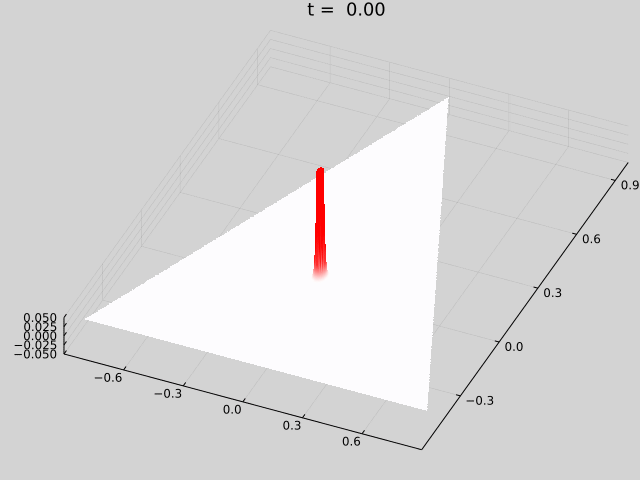

In [11]:
anim_sol(sol; fn="wave eq on triangle with dirichlet bc 3d.gif", zlim=(-0.05, 0.05))

In [12]:
tspan = (0.0, 2.0)
prob = SecondOrderODEProblem(g_neumann!, v0, u0, tspan, p)

sol = nothing; GC.gc()
@time sol = solve(prob; saveat=0.01)

(; u) = sol
umin = minimum(minimum(u.x[2]) for u in u)
umax = maximum(maximum(u.x[2]) for u in u)
@show umin, umax;

  8.930245 seconds (12.42 M allocations: 772.269 MiB, 1.03% gc time, 59.62% compilation time)
(umin, umax) = (-0.29967180989445613, 1.0)


Progress: 100%|█████████████████████████████████████████| Time: 0:00:20
┌ Info: Saved animation to 
│   fn = D:\OneDrive\public\0025\wave eq on triangle with neumann bc.gif
└ @ Plots D:\.julia\packages\Plots\FCM0H\src\animation.jl:114


Plots.AnimatedGif("D:\\OneDrive\\public\\0025\\wave eq on triangle with neumann bc.gif")
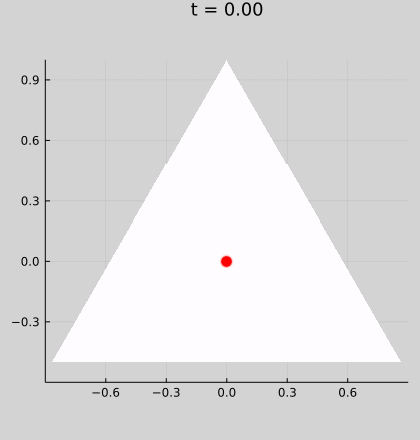

In [13]:
anim_sol2D(sol; fn="wave eq on triangle with neumann bc.gif", clim=(-0.05, 0.05))

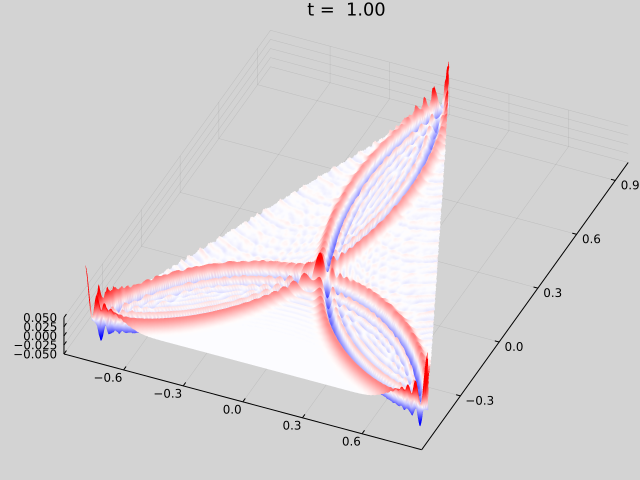

In [14]:
plot_sol(sol, 1.0; zlim=(-0.05, 0.05))

Progress: 100%|█████████████████████████████████████████| Time: 0:00:54
┌ Info: Saved animation to 
│   fn = D:\OneDrive\public\0025\wave eq on triangle with neumann bc 3d.gif
└ @ Plots D:\.julia\packages\Plots\FCM0H\src\animation.jl:114


Plots.AnimatedGif("D:\\OneDrive\\public\\0025\\wave eq on triangle with neumann bc 3d.gif")
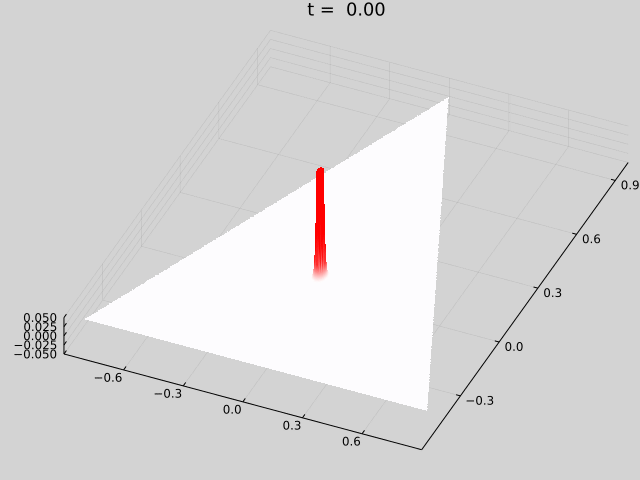

In [15]:
anim_sol(sol; fn="wave eq on triangle with neumann bc 3d.gif", zlim=(-0.05, 0.05))

In [16]:
tspan = (0.0, 3.0)
prob = SecondOrderODEProblem(g_absorbing!, v0, u0, tspan, p)

sol = nothing; GC.gc()
@time sol = solve(prob; saveat=0.01)

(; u) = sol
umin = minimum(minimum(u.x[2]) for u in u)
umax = maximum(maximum(u.x[2]) for u in u)
@show umin, umax;

 11.759255 seconds (12.42 M allocations: 851.988 MiB, 0.84% gc time, 47.38% compilation time)
(umin, umax) = (-0.29967180989445613, 1.0)


Progress: 100%|█████████████████████████████████████████| Time: 0:00:29
┌ Info: Saved animation to 
│   fn = D:\OneDrive\public\0025\wave eq on triangle with absorbing bc.gif
└ @ Plots D:\.julia\packages\Plots\FCM0H\src\animation.jl:114


Plots.AnimatedGif("D:\\OneDrive\\public\\0025\\wave eq on triangle with absorbing bc.gif")
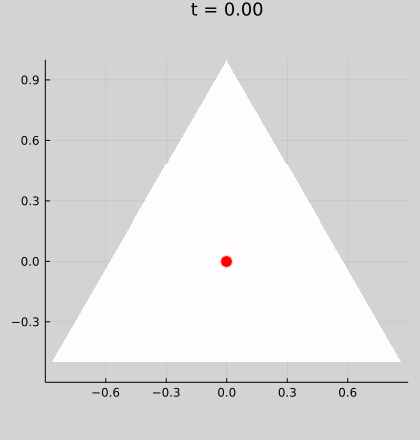

In [17]:
anim_sol2D(sol; L=301, fn="wave eq on triangle with absorbing bc.gif", clim=(-0.05, 0.05))

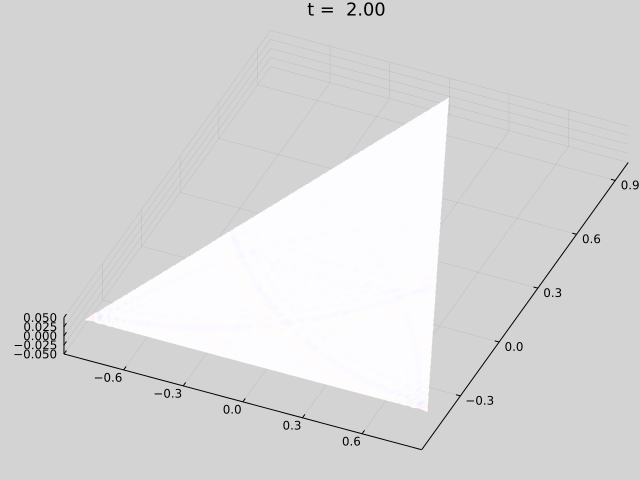

In [18]:
plot_sol(sol, 2.0; zlim=(-0.05, 0.05))

Progress: 100%|█████████████████████████████████████████| Time: 0:01:13
┌ Info: Saved animation to 
│   fn = D:\OneDrive\public\0025\wave eq on triangle with absorbing bc 3d.gif
└ @ Plots D:\.julia\packages\Plots\FCM0H\src\animation.jl:114


Plots.AnimatedGif("D:\\OneDrive\\public\\0025\\wave eq on triangle with absorbing bc 3d.gif")
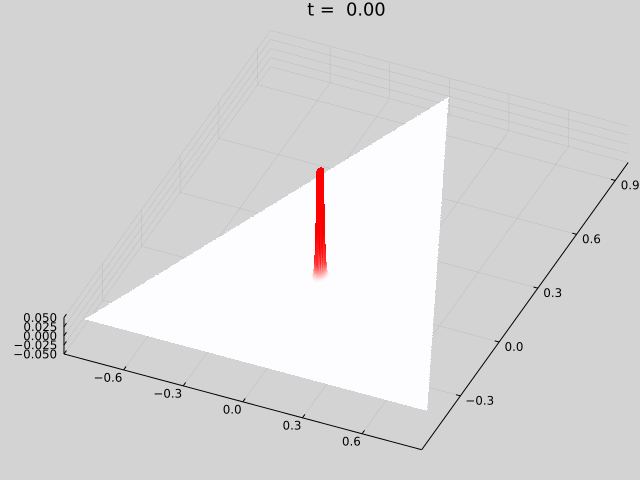

In [19]:
anim_sol(sol; L=151, fn="wave eq on triangle with absorbing bc 3d.gif", zlim=(-0.05, 0.05))